In [102]:
import sys
import os
import string
import glob
import cv2


import numpy as np
import matplotlib.pyplot as plt
from PIL import Image


from matplotlib.animation import FuncAnimation, MovieWriter
from mpl_toolkits.axes_grid1.axes_divider import make_axes_locatable
from itertools import product

import massPy as mp
from utils import *
from plot_utils import *

from AnalyseDefects_dev import AnalyseDefects

plt.style.use('sg_article')

In [2]:
act=0.022
Nexp=0
image_folder = f"C:\\Users\\Simon Andersen\\Documents\\Uni\\Speciale\\Hyperuniformity\\na2048_figs\\analysis_zeta_{act}\\zeta_{act}_counter_0"
make_movie(image_folder, act=act, Nexp=Nexp, resize_factor=.5)
video_name = os.path.join(image_folder, f"zeta_{act}_counter_{Nexp}.mp4")
print(os.path.getsize(video_name)/(1024**2))

Video saved as C:\Users\Simon Andersen\Documents\Uni\Speciale\Hyperuniformity\na2048_figs\analysis_zeta_0.022\zeta_0.022_counter_0\zeta_0.022_counter_0.mp4
16.139232635498047


In [3]:
path = 'C:\\Users\\Simon Andersen\\Dokumenter\\Uni\\Speciale\\Hyperuniformity\\nematic_data'

data_dirs = os.listdir(path)
data_dirs = [os.path.join(path, d) for d in data_dirs]
ar = mp.archive.loadarchive(data_dirs[0])
dirr = data_dirs[9]

frame = ar._read_frame(0)
LX = ar.LX
LY = ar.LY 
Qxx_dat = frame.QQxx.reshape(LX, LY)
Qyx_dat = frame.QQyx.reshape(LX, LY)

defects = mp.nematic.nematicPy.get_defects(Qxx_dat, Qyx_dat, LX, LY)
S, nx, ny = mp.nematic.nematicPy.get_director(Qxx_dat, Qyx_dat)
charges = mp.nematic.nematicPy.get_charge(Qxx_dat, Qyx_dat, LX, LY)
def_arr = get_defect_arr_from_frame(defects)
charge_arr = np.array([defects[i]['charge'] for i in np.arange(len(defects))])
plus_mask = (charge_arr > 0)

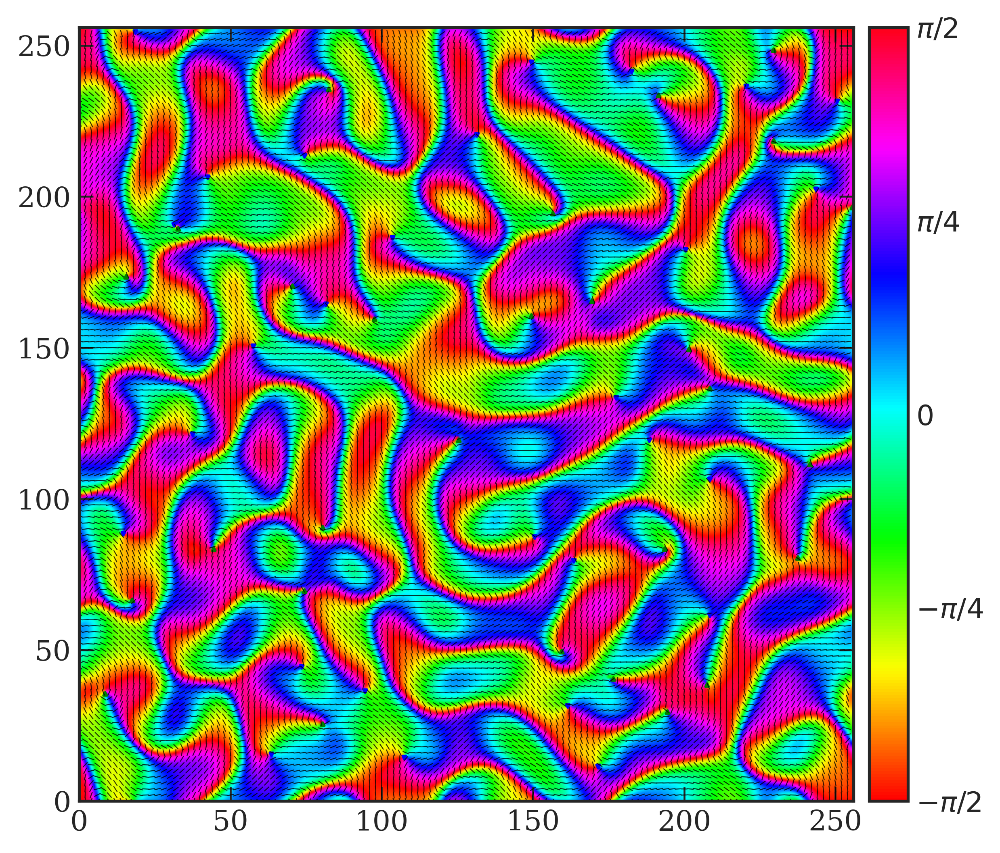

In [36]:

fig, ax = plt.subplots(figsize=(6,6)) 
defect_ms = 2
director_dict = {'scale': False, 'avg': 2, 'ms':  .5, 'alpha': .8, 'lw': .4}    
director(frame=frame, Qxx=Qxx_dat, Qyx=Qyx_dat, engine=ax, **director_dict)
ax.scatter(def_arr[plus_mask, 0], def_arr[plus_mask, 1], c='g', alpha=1,marker='^', s=defect_ms)
mp.nematic.plot.directorwheel(frame,ax)
ax.scatter(def_arr[~plus_mask, 0], def_arr[~plus_mask, 1], c='b', alpha=1,marker='v', s=defect_ms)   
ax.set_aspect('equal')
ax.set(xlim=[0,LX], ylim=[0,LY]); 

In [74]:
parent_path = 'C:\\Users\\Simon Andersen\\Dokumenter\\Uni\\Speciale\\Hyperuniformity\\nematic_data'

data_dirs = os.listdir(parent_path)
data_dirs = [os.path.join(parent_path, d) for d in data_dirs]
#ar = mp.archive.loadarchive(data_dirs[0])

path = os.path.join(parent_path, os.listdir(parent_path)[11])
fig_path = os.path.join(path, 'figs')
if not os.path.exists(fig_path):
    os.makedirs(fig_path)

# use only a subset of frames if development_mode
Njump = 1
num_frames = len(os.listdir(path)) - 2
first_frame_idx = 0
frame_interval = [first_frame_idx, first_frame_idx + num_frames]

ar = mp.archive.loadarchive(path)
LX, LY = ar.__dict__['LX'], ar.__dict__['LY']

# Get defect list
top_defects = get_defect_list(ar, Nframes = num_frames, archive_path=path)


In [ ]:
# set plotting parameters
director_dict = {'scale': False, 'avg': 4, 'ms':  .5, 'alpha': .3, 'lw': .4}

dpi = 320 #420
defect_ms = 1 #if act < 0.024 else .6
# set video parameters
video_dict = {'resize_factor': .5, 'fps': 5}

for frame_idx in range(frame_interval[0], frame_interval[1], Njump):
    frame = ar._read_frame(frame_idx)
    defects = top_defects[frame_idx]
    save_path = os.path.join(fig_path, f'defect_director_{frame_idx}.png') 
    title=r'$\zeta = 0.028$'
    plot_defects(frame, defect_dict=defects, defect_ms = defect_ms, \
                 director_dict=director_dict, title=title,
                 save_path=save_path, dpi = dpi)

make_movie(fig_path, act=0.028, Nexp=0, resize_factor=.5, fps=5)


#### Below we plot a frame from each archive

In [3]:
paths = [data_dirs[7], data_dirs[9], data_dirs[10], data_dirs[11]] #, data_dirs[3]]
act_list = [19, 0.0205, 0.021, 0.022] #, 0.028, 0.06]

paths2 = [data_dirs[3], data_dirs[4], data_dirs[-7]]
act_list2 = [0.019, 0.022, 0.022]

In [186]:
path = paths[3]
fn = 3
ar = mp.archive.loadarchive(path)
f = get_frame_number(fn, path, ar.ninfo)
frame = ar._read_frame(f)

LX = ar.LX
LY = ar.LY 
Qxx_dat = frame.QQxx.reshape(LX, LY)
Qyx_dat = frame.QQyx.reshape(LX, LY)

defects = mp.nematic.nematicPy.get_defects(Qxx_dat, Qyx_dat, LX, LY)
S, nx, ny = mp.nematic.nematicPy.get_director(Qxx_dat, Qyx_dat)
charges = mp.nematic.nematicPy.get_charge(Qxx_dat, Qyx_dat, LX, LY)
def_arr = get_defect_arr_from_frame(defects)
charge_arr = np.array([defects[i]['charge'] for i in np.arange(len(defects))])
plus_mask = (charge_arr > 0)

In [ ]:
fig, ax = plt.subplots()
vorticity_abs(frame, ax, abs=True)
#mp.nematic.plot.vorticity(frame, ax)
#mp.nematic.plot.defects(frame, ax)
ax.scatter(def_arr[plus_mask, 0], def_arr[plus_mask, 1], c='g', alpha=.8,marker='^', s=15)
ax.scatter(def_arr[~plus_mask, 0], def_arr[~plus_mask, 1], c='b', alpha=.8,marker='v', s=15)
ax.set_aspect('equal')
ax.set(xlim=[LX/4,3*LX/4], ylim=[LX/4,3*LX/4],);   

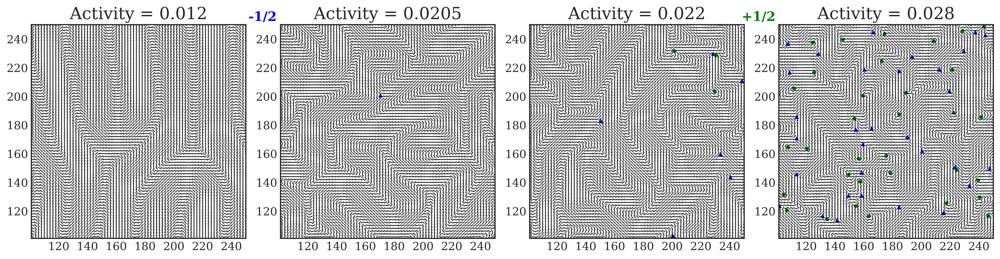

In [170]:


fig, ax = plt.subplots(ncols=4,figsize=(15,4))
ax = ax.flatten()
for i, path in enumerate(paths2):
    
    fn = 3
    ar = mp.archive.loadarchive(path)
    f = get_frame_number(fn, path, ar.ninfo)
    frame = ar._read_frame(f)
    ax[i].set_title(f'Activity = {act_list2[i]}')

    LX = ar.LX
    LY = ar.LY 
    Qxx_dat = frame.QQxx.reshape(LX, LY)
    Qyx_dat = frame.QQyx.reshape(LX, LY)
    
    #defects = mp.nematic.nematicPy.get_defects(Qxx_dat, Qyx_dat, LX, LY)
    #print(f"Ndefects for act = {act_list[i]}: ", len(defects))

    ms = 3
    alpha = 1
    avg = 2
    ms_dir, lw_dir = .8,1
    #ms_dir, lw_dir = .7,.7

    Lstart = 101
    Lend = 250
    xticks=range(Lstart + 19, Lend, 20)

    
    for row in range(ax.shape[0]):
        ax[i].xaxis.set_ticks_position('none') 
        ax[i].yaxis.set_ticks_position('none')
        ax[i].set_aspect('equal')  
       # ax[i].set(xlim=[LX/denom,numerator*LX/denom], ylim=[LX/denom,numerator*LX/denom]); 
        ax[i].set(xlim=[Lstart,Lend], ylim=[Lstart,Lend], xticks=xticks, yticks=xticks); 
        mp.nematic.plot.defects(frame, ax[i], ms = ms, alpha=alpha)

    
    mp.nematic.plot.director(frame, ax[i], ms = ms_dir, lw=lw_dir, avg=avg, alpha=.8)
   # mp.nematic.plot.velocity(frame, ax[1, i], avg=4)

    #mp.nematic.plot.defects(frame, ax[0, i], ms = ms,)
#ax = ax.T

fig.text(0.25, 0.9, '-1/2', fontsize=14, verticalalignment='bottom', color='blue', fontweight='bold')
fig.text(0.74, 0.9, '+1/2',fontsize=14, verticalalignment='bottom', color='green', fontweight='bold');
fig.tight_layout()
fig.dpi= 720

In [142]:
paths = [data_dirs[7], data_dirs[9], data_dirs[10], data_dirs[11]] #, data_dirs[3]]
act_list = [19, 0.0205, 0.021, 0.022] #, 0.028, 0.06]

paths2 = [data_dirs[-3], data_dirs[9], data_dirs[-5], data_dirs[-4]]
act_list2 = [0.012, 0.0205, 0.022, 0.028]

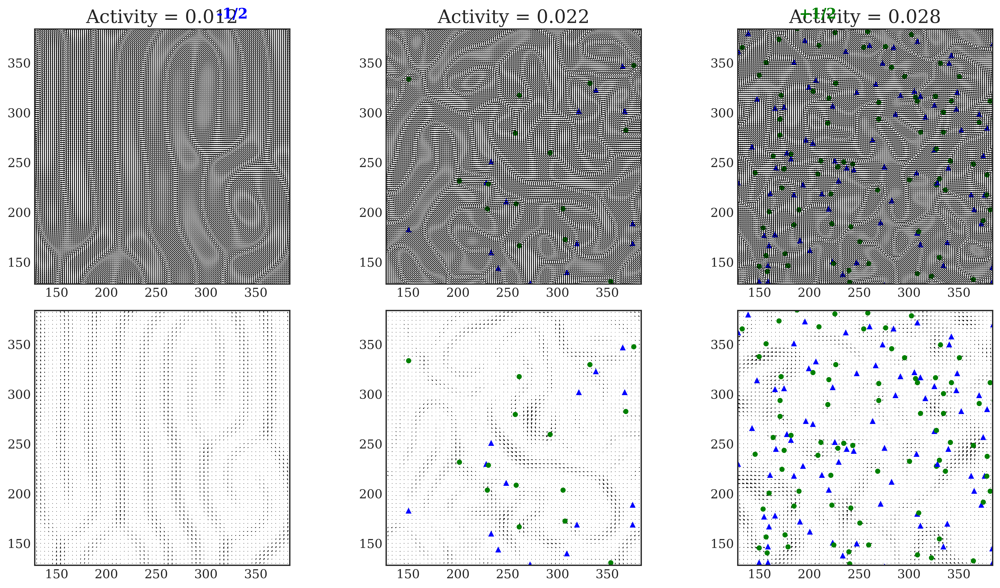

In [126]:
fig, ax = plt.subplots(nrows=2,ncols=4,figsize=(16,8))
for i, path in enumerate(paths):
    
    fn = 3
    ar = mp.archive.loadarchive(path)
    f = get_frame_number(fn, path, ar.ninfo)
    frame = ar._read_frame(f)
    ax[0,i].set_title(f'Activity = {act_list[i]}')

    LX = ar.LX
    LY = ar.LY 
    Qxx_dat = frame.QQxx.reshape(LX, LY)
    Qyx_dat = frame.QQyx.reshape(LX, LY)
    
    #defects = mp.nematic.nematicPy.get_defects(Qxx_dat, Qyx_dat, LX, LY)
    #print(f"Ndefects for act = {act_list[i]}: ", len(defects))

    ms = 3 if i == 3 else 4
    alpha = .8 if i == 3 else 1
    avg = 4
   
    
    for row in range(ax.shape[0]):
        ax[row, i].xaxis.set_ticks_position('none') 
        ax[row, i].yaxis.set_ticks_position('none')
        ax[row,i].set_aspect('equal')  
      #  ax[row,i].set(xlim=[LX/4,3*LX/4], ylim=[LX/4,3*LX/4]); 
        mp.nematic.plot.defects(frame, ax[row, i], ms = ms, alpha=alpha)
    
    mp.nematic.plot.director(frame, ax[0, i], ms = .5, lw=.7, avg=avg)
    mp.nematic.plot.velocity(frame, ax[1, i], avg=4)

    #mp.nematic.plot.defects(frame, ax[0, i], ms = ms,)
#ax = ax.T
fig.text(0.25, 0.96, '-1/2', fontsize=14, verticalalignment='bottom', color='blue', fontweight='bold')
fig.text(0.74, 0.96, '+1/2',fontsize=14, verticalalignment='bottom', color='green', fontweight='bold');

#### Below we plot N frames from a given archive

In [20]:
path = data_dirs[12]
act = .022
Nframes = 4 # len(os.listdir(path)) - 1
Njump = 1
ar = mp.archive.loadarchive(path)
path

'C:\\Users\\Simon Andersen\\Dokumenter\\Uni\\Speciale\\Hyperuniformity\\nematic_data\\ns512a28n0'

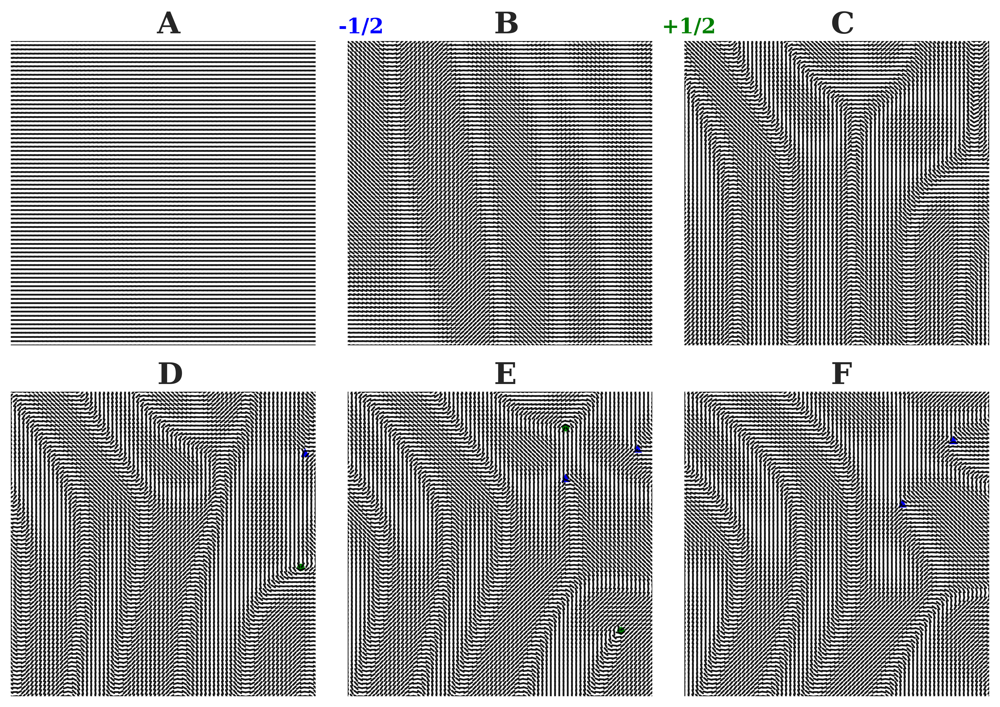

In [67]:



nrows = int(np.ceil(Nframes/3))
fig_height = 6 * nrows
fig, ax = plt.subplots(nrows=2,ncols=3,figsize=(10,2/3*10))
ax = ax.flatten()
Nframes = 6
first_frame_idx = 1
for i in range(Nframes):
    
    if i == 2:
        first_frame_idx += 1
    if i == 5:
        first_frame_idx += 0
    f = get_frame_number(i + first_frame_idx, path, ar.ninfo)
    frame = ar._read_frame(f)
    
    # Get actual frame number
    frame_num = ar.nstart + f * ar.ninfo

    LX = ar.LX
    LY = ar.LY 
    LXB = 220
    Qxx_dat = frame.QQxx.reshape(LX, LY)
    Qyx_dat = frame.QQyx.reshape(LX, LY)
    
    defects = mp.nematic.nematicPy.get_defects(Qxx_dat, Qyx_dat, LX, LY)

    ms = 4
    alpha = 1
    ms = 4
    alpha = 1
    avg = 1
    ms_dir, lw_dir, alpha_dir = 1.2, 1.2, .9

    ax[i].xaxis.set_ticks_position('none')
    ax[i].yaxis.set_ticks_position('none')
    ax[i].set_aspect('equal')   
    xticks = range(LXB + 10, LX-LXB, 20)
    ax[i].set(xlim=[LXB,LX-LXB], ylim=[LXB,LX-LXB], xticks=xticks,yticks=xticks);
    ax[i].axis('off')   


    mp.nematic.plot.defects(frame, ax[i], ms = ms, alpha=alpha,)
    mp.nematic.plot.director(frame, ax[i], ms = ms_dir, lw=lw_dir, alpha=alpha_dir, avg = avg)

for n, axx in enumerate(ax):
    ax[n].text(.48, 1.025, string.ascii_uppercase[n], transform=ax[n].transAxes,
            size=20, weight='bold')

fig.text(0.35, 0.94, '-1/2', fontsize=14, verticalalignment='bottom', color='blue', fontweight='bold')
fig.text(0.65, 0.94, '+1/2',fontsize=14, verticalalignment='bottom', color='green', fontweight='bold');

fig.tight_layout()

#### Animate N frames from a given archive

In [ ]:
Nframes = len([i for i in os.listdir(path) if i.startswith('frame')])
plotter = lambda frame, engine: frame_plotter(frame, plot_director = False, ms = 4, engine = engine)
animate(oa=ar, fn=plotter, rng=[0, Nframes], inter=2000, show=False, save=True, save_path=save_path);

print("Animation size (MB):", os.path.getsize('anim_L512_zeta0.019.mp4') / 1024 ** 2)